In [2]:
import tensorflow as tf
from tensorflow.keras import layers
import os

class CelebADatasetTF:
    def __init__(self, root_dir, image_size=(128, 128), batch_size=32, shuffle=True):
        self.root_dir = root_dir
        self.image_size = image_size
        self.batch_size = batch_size
        self.shuffle = shuffle

        self.image_paths = [
            os.path.join(root_dir, img)
            for img in os.listdir(root_dir)
            if img.endswith(".jpg")
        ]

    def _load_image(self, image_path):
        image = tf.io.read_file(image_path)
        image = tf.image.decode_jpeg(image, channels=3)
        image = tf.image.resize(image, self.image_size)
        image = tf.cast(image, tf.float32) / 255.0  # normalize [0,1]
        return image

    def get_dataset(self):
        dataset = tf.data.Dataset.from_tensor_slices(self.image_paths)
        dataset = dataset.map(
            lambda x: self._load_image(x),
            num_parallel_calls=tf.data.AUTOTUNE
        )

        if self.shuffle:
            dataset = dataset.shuffle(buffer_size=1000)

        dataset = dataset.batch(self.batch_size)
        dataset = dataset.prefetch(tf.data.AUTOTUNE)
        return dataset


In [3]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
celeb_path = "/content/drive/MyDrive/celebA"

print("celebA exists:", os.path.exists(celeb_path))
print("Is directory:", os.path.isdir(celeb_path))
print("Files inside celebA (first 30):")
print(os.listdir(celeb_path)[:30])


celebA exists: True
Is directory: True
Files inside celebA (first 30):
['024167.png', '024094.png', '022976.png', '023295.png', '024157.png', '023081.png', '022986.png', '024066.png', '024033.png', '022705.png', '023122.png', '023698.png', '023500.png', '024060.png', '023273.png', '022919.png', '022758.png', '023188.png', '023905.png', '022707.png', '023875.png', '022722.png', '022859.png', '022730.png', '024148.png', '023278.png', '022683.png', '022778.png', '023952.png', '023988.png']


In [6]:
import tensorflow as tf
import glob

def preprocess_image(image_path):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_image(image, channels=3, expand_animations=False)
    image = tf.image.resize(image, [64, 64])
    image = (tf.cast(image, tf.float32) / 127.5) - 1.0
    return image

image_paths = glob.glob("/content/drive/MyDrive/celebA/*.png")

print("Total number of images loaded:", len(image_paths))
assert len(image_paths) > 0, "❌ No images found!"

dataset = tf.data.Dataset.from_tensor_slices(image_paths)
dataset = dataset.map(preprocess_image, num_parallel_calls=tf.data.AUTOTUNE)
dataset = dataset.shuffle(1000).batch(128).prefetch(tf.data.AUTOTUNE)





Total number of images loaded: 24173


In [7]:
#generator class
class Generator(tf.keras.Model):
    def __init__(self, z_dim=100):
        super().__init__()
        self.model = tf.keras.Sequential([
            layers.Dense(256, activation="relu"),
            layers.Dense(512, activation="relu"),
            layers.Dense(1024, activation="relu"),
            layers.Dense(3 * 64 * 64, activation="tanh"),
            layers.Reshape((64, 64, 3))
        ])

    def call(self, z):
        return self.model(z)


In [8]:
#discriminator
class Discriminator(tf.keras.Model):
    def __init__(self):
        super().__init__()
        self.model = tf.keras.Sequential([
            layers.Flatten(),
            layers.Dense(1024),
            layers.LeakyReLU(0.2),
            layers.Dense(512),
            layers.LeakyReLU(0.2),
            layers.Dense(256),
            layers.LeakyReLU(0.2),
            layers.Dense(1, activation="sigmoid")
        ])

    def call(self, img):
        return self.model(img)


In [9]:
#losses and optimizers
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=False)

generator = Generator()
discriminator = Discriminator()

generator_optimizer = tf.keras.optimizers.Adam(
    learning_rate=0.0002, beta_1=0.5
)
discriminator_optimizer = tf.keras.optimizers.Adam(
    learning_rate=0.0002, beta_1=0.5
)


In [10]:
#traning fnct
@tf.function
def train_step(real_images, batch_size, z_dim=100):

    noise = tf.random.normal([batch_size, z_dim])

    valid = tf.ones((batch_size, 1))
    fake = tf.zeros((batch_size, 1))

    # ---------------------
    # Train Discriminator
    # ---------------------
    with tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)

        real_output = discriminator(real_images, training=True)
        fake_output = discriminator(generated_images, training=True)

        real_loss = cross_entropy(valid, real_output)
        fake_loss = cross_entropy(fake, fake_output)
        d_loss = (real_loss + fake_loss) / 2

    grads_D = disc_tape.gradient(d_loss, discriminator.trainable_variables)
    discriminator_optimizer.apply_gradients(
        zip(grads_D, discriminator.trainable_variables)
    )

    # ---------------------
    # Train Generator
    # ---------------------
    with tf.GradientTape() as gen_tape:
        generated_images = generator(noise, training=True)
        fake_output = discriminator(generated_images, training=True)
        g_loss = cross_entropy(valid, fake_output)

    grads_G = gen_tape.gradient(g_loss, generator.trainable_variables)
    generator_optimizer.apply_gradients(
        zip(grads_G, generator.trainable_variables)
    )

    return d_loss, g_loss


In [11]:
#save generated imags
def save_generated_images(generator, epoch, num_images=16):
    noise = tf.random.normal([num_images, 100])
    generated_images = generator(noise, training=False)

    generated_images = (generated_images + 1) / 2  # [-1,1] → [0,1]

    plt.figure(figsize=(4,4))
    for i in range(num_images):
        plt.subplot(4,4,i+1)
        plt.imshow(generated_images[i])
        plt.axis("off")

    plt.suptitle(f"Epoch {epoch}")
    plt.show()


In [12]:
#training loop
def train(dataset, epochs=10):
    for epoch in range(epochs):
        for batch_idx, real_images in enumerate(dataset):
            batch_size = real_images.shape[0]

            d_loss, g_loss = train_step(real_images, batch_size)

            if batch_idx % 50 == 0:
                print(
                    f"[Epoch {epoch}/{epochs}] "
                    f"[Batch {batch_idx}] "
                    f"[D loss: {d_loss.numpy():.4f}] "
                    f"[G loss: {g_loss.numpy():.4f}]"
                )

        save_generated_images(generator, epoch)


In [14]:
import matplotlib.pyplot as plt


[Epoch 0/100] [Batch 0] [D loss: 0.3083] [G loss: 2.2081]
[Epoch 0/100] [Batch 50] [D loss: 0.4567] [G loss: 2.1938]
[Epoch 0/100] [Batch 100] [D loss: 0.2618] [G loss: 3.3699]
[Epoch 0/100] [Batch 150] [D loss: 0.2682] [G loss: 3.3857]


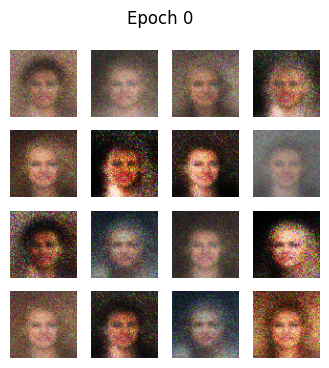

[Epoch 1/100] [Batch 0] [D loss: 0.2238] [G loss: 2.5366]
[Epoch 1/100] [Batch 50] [D loss: 0.2618] [G loss: 2.7979]
[Epoch 1/100] [Batch 100] [D loss: 0.2646] [G loss: 2.9915]
[Epoch 1/100] [Batch 150] [D loss: 0.2813] [G loss: 2.7822]


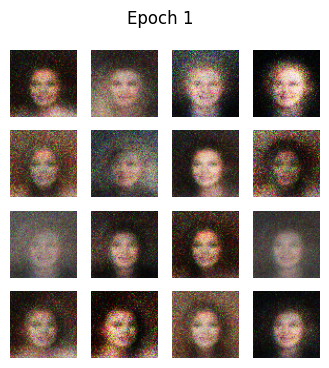

[Epoch 2/100] [Batch 0] [D loss: 0.3413] [G loss: 1.9307]
[Epoch 2/100] [Batch 50] [D loss: 0.2320] [G loss: 2.5976]
[Epoch 2/100] [Batch 100] [D loss: 0.3056] [G loss: 2.5653]
[Epoch 2/100] [Batch 150] [D loss: 0.2661] [G loss: 2.6283]


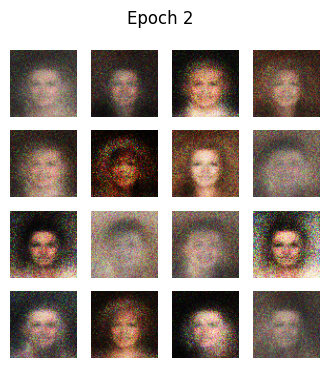

[Epoch 3/100] [Batch 0] [D loss: 0.2796] [G loss: 2.3959]
[Epoch 3/100] [Batch 50] [D loss: 0.2336] [G loss: 2.7534]
[Epoch 3/100] [Batch 100] [D loss: 0.3458] [G loss: 3.3070]
[Epoch 3/100] [Batch 150] [D loss: 0.2948] [G loss: 2.4005]


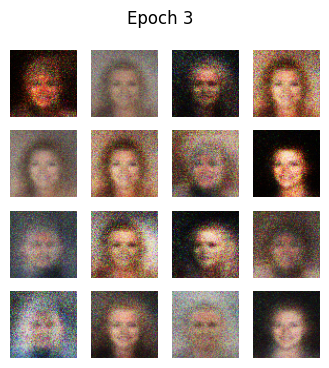

[Epoch 4/100] [Batch 0] [D loss: 0.2619] [G loss: 2.8447]
[Epoch 4/100] [Batch 50] [D loss: 0.3553] [G loss: 2.2453]
[Epoch 4/100] [Batch 100] [D loss: 0.3399] [G loss: 2.7969]
[Epoch 4/100] [Batch 150] [D loss: 0.3092] [G loss: 2.8056]


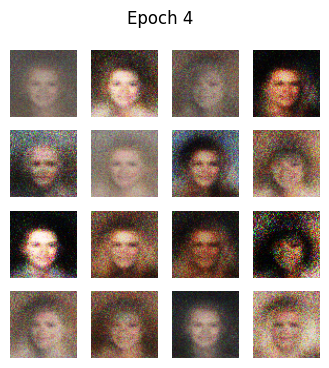

[Epoch 5/100] [Batch 0] [D loss: 0.2740] [G loss: 2.4883]
[Epoch 5/100] [Batch 50] [D loss: 0.3280] [G loss: 2.7969]
[Epoch 5/100] [Batch 100] [D loss: 0.3329] [G loss: 3.7336]
[Epoch 5/100] [Batch 150] [D loss: 0.2505] [G loss: 2.7353]


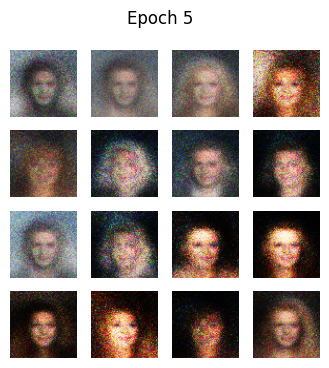

[Epoch 6/100] [Batch 0] [D loss: 0.3221] [G loss: 2.4725]
[Epoch 6/100] [Batch 50] [D loss: 0.3621] [G loss: 3.3139]
[Epoch 6/100] [Batch 100] [D loss: 0.3332] [G loss: 3.1508]
[Epoch 6/100] [Batch 150] [D loss: 0.2908] [G loss: 3.0801]


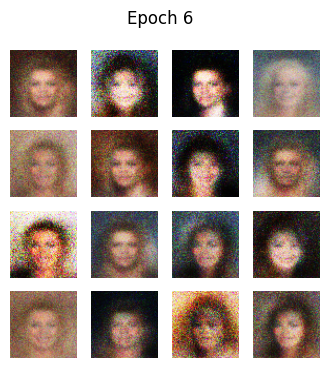

[Epoch 7/100] [Batch 0] [D loss: 0.3468] [G loss: 3.2838]
[Epoch 7/100] [Batch 50] [D loss: 0.4113] [G loss: 2.3555]
[Epoch 7/100] [Batch 100] [D loss: 0.4638] [G loss: 2.8953]
[Epoch 7/100] [Batch 150] [D loss: 0.3478] [G loss: 2.6147]


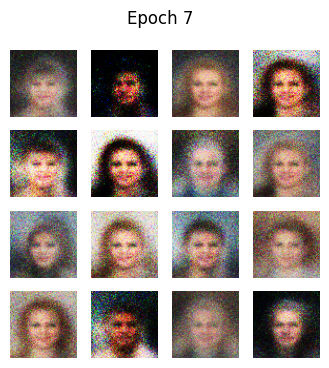

[Epoch 8/100] [Batch 0] [D loss: 0.3319] [G loss: 2.7482]
[Epoch 8/100] [Batch 50] [D loss: 0.3884] [G loss: 2.3904]
[Epoch 8/100] [Batch 100] [D loss: 0.4586] [G loss: 1.8006]
[Epoch 8/100] [Batch 150] [D loss: 0.3427] [G loss: 2.3867]


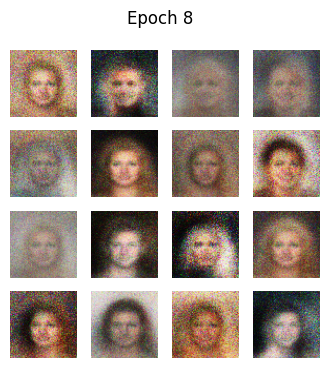

[Epoch 9/100] [Batch 0] [D loss: 0.3522] [G loss: 2.4335]
[Epoch 9/100] [Batch 50] [D loss: 0.3963] [G loss: 2.4280]
[Epoch 9/100] [Batch 100] [D loss: 0.3749] [G loss: 2.1273]
[Epoch 9/100] [Batch 150] [D loss: 0.3773] [G loss: 1.6269]


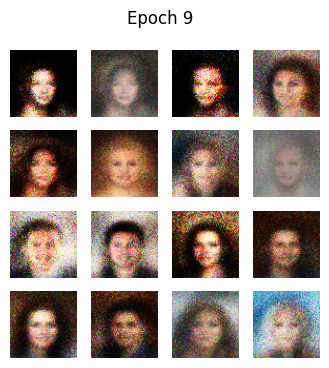

[Epoch 10/100] [Batch 0] [D loss: 0.3601] [G loss: 2.6992]
[Epoch 10/100] [Batch 50] [D loss: 0.4833] [G loss: 2.7281]
[Epoch 10/100] [Batch 100] [D loss: 0.4052] [G loss: 2.3262]
[Epoch 10/100] [Batch 150] [D loss: 0.3981] [G loss: 2.2956]


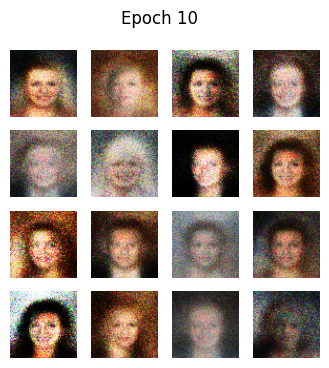

[Epoch 11/100] [Batch 0] [D loss: 0.4197] [G loss: 1.8482]
[Epoch 11/100] [Batch 50] [D loss: 0.4086] [G loss: 2.0724]
[Epoch 11/100] [Batch 100] [D loss: 0.3447] [G loss: 2.4667]
[Epoch 11/100] [Batch 150] [D loss: 0.2947] [G loss: 2.8860]


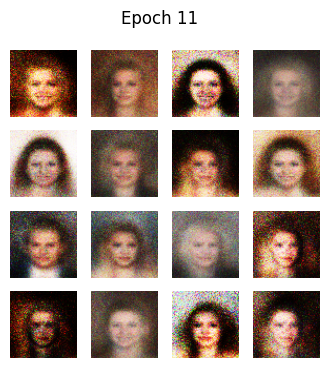

[Epoch 12/100] [Batch 0] [D loss: 0.3771] [G loss: 2.1774]
[Epoch 12/100] [Batch 50] [D loss: 0.6640] [G loss: 3.3098]
[Epoch 12/100] [Batch 100] [D loss: 0.4363] [G loss: 2.3010]
[Epoch 12/100] [Batch 150] [D loss: 0.3989] [G loss: 2.3008]


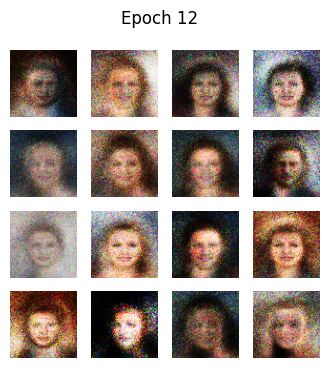

[Epoch 13/100] [Batch 0] [D loss: 0.5090] [G loss: 1.8273]
[Epoch 13/100] [Batch 50] [D loss: 0.3541] [G loss: 2.5043]
[Epoch 13/100] [Batch 100] [D loss: 0.4640] [G loss: 2.3055]
[Epoch 13/100] [Batch 150] [D loss: 0.4120] [G loss: 1.9455]


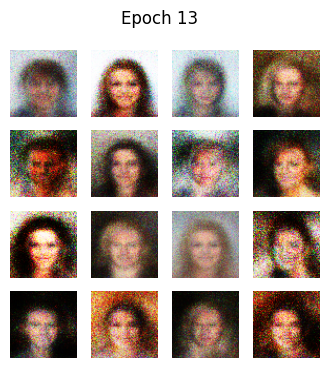

[Epoch 14/100] [Batch 0] [D loss: 0.4493] [G loss: 1.9570]
[Epoch 14/100] [Batch 50] [D loss: 0.5779] [G loss: 1.8432]
[Epoch 14/100] [Batch 100] [D loss: 0.4604] [G loss: 2.1820]
[Epoch 14/100] [Batch 150] [D loss: 0.4984] [G loss: 2.5473]


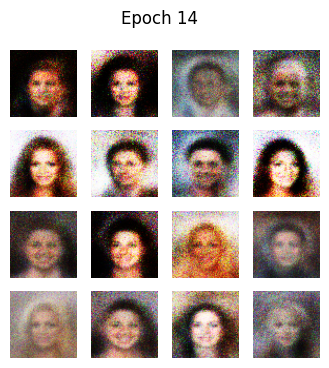

[Epoch 15/100] [Batch 0] [D loss: 0.3441] [G loss: 2.3580]
[Epoch 15/100] [Batch 50] [D loss: 0.4826] [G loss: 2.1922]
[Epoch 15/100] [Batch 100] [D loss: 0.5106] [G loss: 3.1110]
[Epoch 15/100] [Batch 150] [D loss: 0.5195] [G loss: 2.0636]


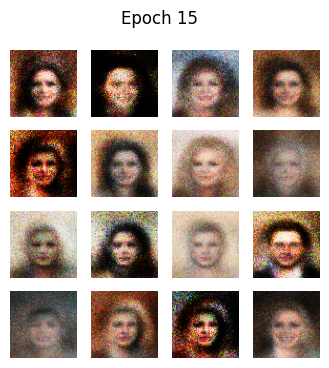

[Epoch 16/100] [Batch 0] [D loss: 0.4182] [G loss: 2.5507]
[Epoch 16/100] [Batch 50] [D loss: 0.3844] [G loss: 1.7441]
[Epoch 16/100] [Batch 100] [D loss: 0.5898] [G loss: 2.6938]
[Epoch 16/100] [Batch 150] [D loss: 0.3887] [G loss: 2.2004]


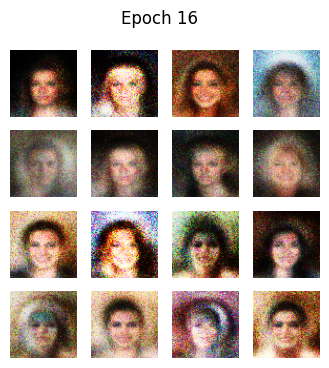

[Epoch 17/100] [Batch 0] [D loss: 0.4376] [G loss: 2.1139]
[Epoch 17/100] [Batch 50] [D loss: 0.3757] [G loss: 2.1561]
[Epoch 17/100] [Batch 100] [D loss: 0.4656] [G loss: 3.6923]
[Epoch 17/100] [Batch 150] [D loss: 0.4093] [G loss: 1.8501]


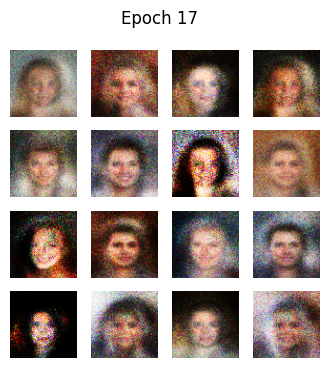

[Epoch 18/100] [Batch 0] [D loss: 0.4425] [G loss: 2.4338]
[Epoch 18/100] [Batch 50] [D loss: 0.3807] [G loss: 2.1899]
[Epoch 18/100] [Batch 100] [D loss: 0.4428] [G loss: 2.4653]
[Epoch 18/100] [Batch 150] [D loss: 0.4136] [G loss: 2.4229]


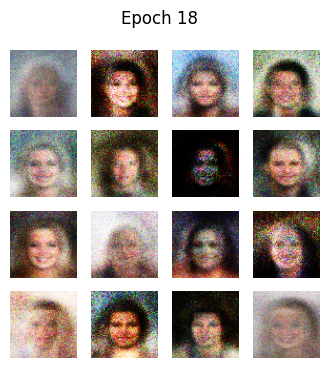

[Epoch 19/100] [Batch 0] [D loss: 0.3727] [G loss: 1.9217]
[Epoch 19/100] [Batch 50] [D loss: 0.4926] [G loss: 2.1317]
[Epoch 19/100] [Batch 100] [D loss: 0.5022] [G loss: 2.0088]
[Epoch 19/100] [Batch 150] [D loss: 0.4357] [G loss: 1.5687]


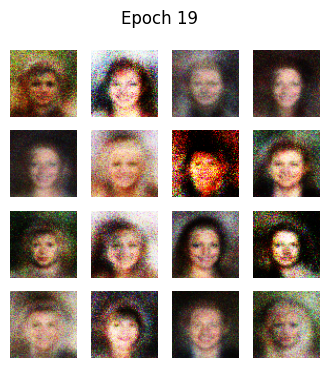

[Epoch 20/100] [Batch 0] [D loss: 0.5193] [G loss: 2.1927]
[Epoch 20/100] [Batch 50] [D loss: 0.4249] [G loss: 2.2833]
[Epoch 20/100] [Batch 100] [D loss: 0.4046] [G loss: 1.7734]
[Epoch 20/100] [Batch 150] [D loss: 0.4652] [G loss: 2.2096]


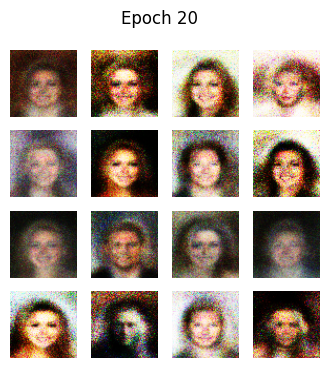

[Epoch 21/100] [Batch 0] [D loss: 0.4286] [G loss: 2.1048]
[Epoch 21/100] [Batch 50] [D loss: 0.4330] [G loss: 1.8715]
[Epoch 21/100] [Batch 100] [D loss: 0.5137] [G loss: 2.2568]
[Epoch 21/100] [Batch 150] [D loss: 0.5428] [G loss: 1.9319]


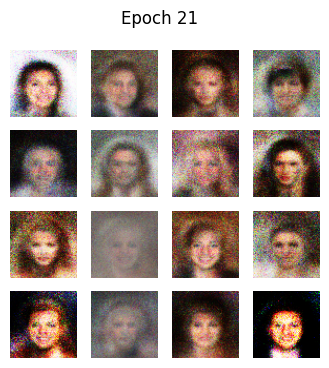

[Epoch 22/100] [Batch 0] [D loss: 0.4479] [G loss: 1.8590]
[Epoch 22/100] [Batch 50] [D loss: 0.5544] [G loss: 2.8111]
[Epoch 22/100] [Batch 100] [D loss: 0.5049] [G loss: 2.2439]
[Epoch 22/100] [Batch 150] [D loss: 0.4702] [G loss: 1.7133]


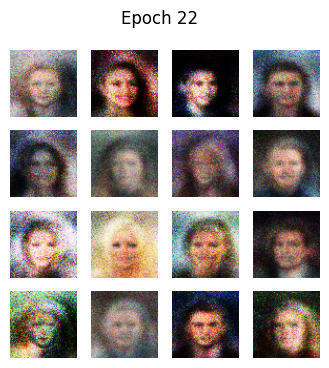

[Epoch 23/100] [Batch 0] [D loss: 0.4823] [G loss: 1.9513]
[Epoch 23/100] [Batch 50] [D loss: 0.4914] [G loss: 2.1492]
[Epoch 23/100] [Batch 100] [D loss: 0.4509] [G loss: 1.8610]
[Epoch 23/100] [Batch 150] [D loss: 0.3952] [G loss: 2.1882]


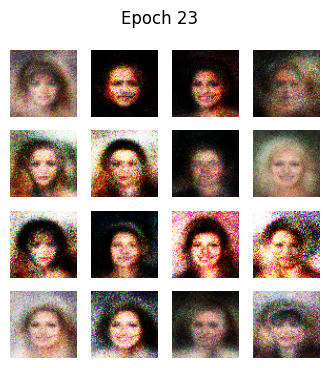

[Epoch 24/100] [Batch 0] [D loss: 0.4728] [G loss: 1.7908]
[Epoch 24/100] [Batch 50] [D loss: 0.5333] [G loss: 2.3214]
[Epoch 24/100] [Batch 100] [D loss: 0.4833] [G loss: 1.9133]
[Epoch 24/100] [Batch 150] [D loss: 0.4748] [G loss: 2.3085]


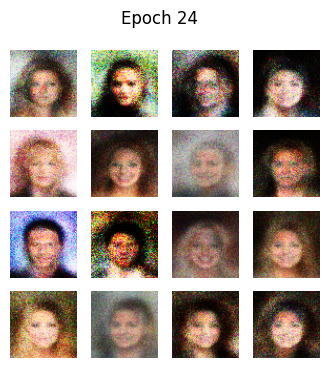

[Epoch 25/100] [Batch 0] [D loss: 0.4027] [G loss: 1.9570]
[Epoch 25/100] [Batch 50] [D loss: 0.4730] [G loss: 2.1090]
[Epoch 25/100] [Batch 100] [D loss: 0.4032] [G loss: 2.1880]
[Epoch 25/100] [Batch 150] [D loss: 0.4713] [G loss: 2.1785]


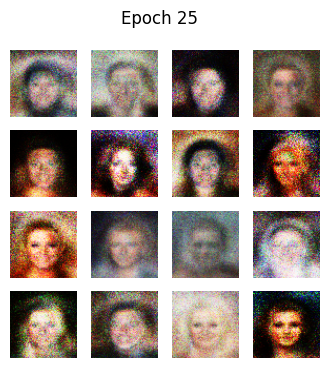

[Epoch 26/100] [Batch 0] [D loss: 0.4675] [G loss: 1.9177]
[Epoch 26/100] [Batch 50] [D loss: 0.4272] [G loss: 2.3279]
[Epoch 26/100] [Batch 100] [D loss: 0.5838] [G loss: 2.3755]
[Epoch 26/100] [Batch 150] [D loss: 0.5118] [G loss: 2.2245]


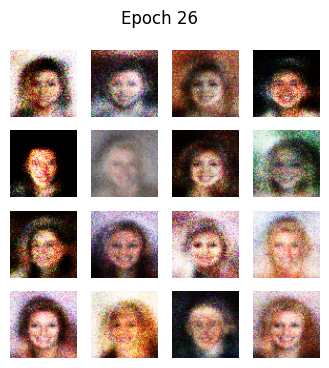

[Epoch 27/100] [Batch 0] [D loss: 0.4619] [G loss: 2.1678]
[Epoch 27/100] [Batch 50] [D loss: 0.4697] [G loss: 1.6339]
[Epoch 27/100] [Batch 100] [D loss: 0.5698] [G loss: 1.8800]
[Epoch 27/100] [Batch 150] [D loss: 0.5279] [G loss: 1.3783]


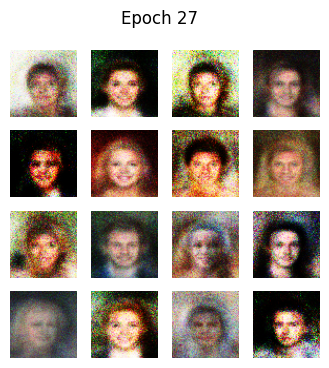

[Epoch 28/100] [Batch 0] [D loss: 0.4298] [G loss: 2.1083]
[Epoch 28/100] [Batch 50] [D loss: 0.4987] [G loss: 1.9089]
[Epoch 28/100] [Batch 100] [D loss: 0.5021] [G loss: 1.6682]
[Epoch 28/100] [Batch 150] [D loss: 0.4457] [G loss: 2.6990]


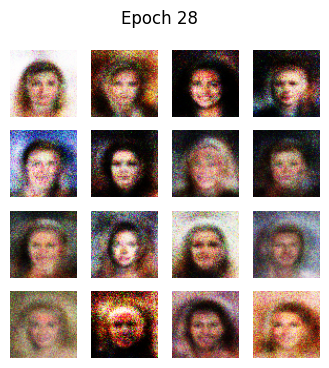

[Epoch 29/100] [Batch 0] [D loss: 0.4904] [G loss: 1.9463]
[Epoch 29/100] [Batch 50] [D loss: 0.5308] [G loss: 2.1695]
[Epoch 29/100] [Batch 100] [D loss: 0.5253] [G loss: 2.0216]
[Epoch 29/100] [Batch 150] [D loss: 0.4151] [G loss: 2.2557]


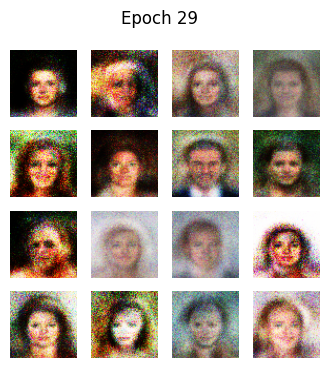

[Epoch 30/100] [Batch 0] [D loss: 0.4767] [G loss: 1.9665]
[Epoch 30/100] [Batch 50] [D loss: 0.4304] [G loss: 2.0388]
[Epoch 30/100] [Batch 100] [D loss: 0.5174] [G loss: 1.7579]
[Epoch 30/100] [Batch 150] [D loss: 0.4534] [G loss: 1.9414]


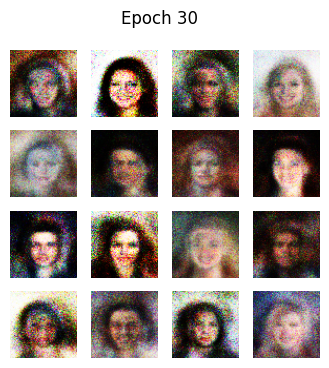

[Epoch 31/100] [Batch 0] [D loss: 0.4395] [G loss: 2.0205]
[Epoch 31/100] [Batch 50] [D loss: 0.5166] [G loss: 2.1220]
[Epoch 31/100] [Batch 100] [D loss: 0.4635] [G loss: 1.9485]
[Epoch 31/100] [Batch 150] [D loss: 0.5060] [G loss: 2.2224]


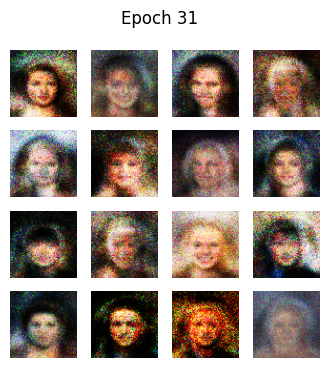

[Epoch 32/100] [Batch 0] [D loss: 0.5013] [G loss: 1.9080]
[Epoch 32/100] [Batch 50] [D loss: 0.4588] [G loss: 2.0655]
[Epoch 32/100] [Batch 100] [D loss: 0.4745] [G loss: 1.6038]
[Epoch 32/100] [Batch 150] [D loss: 0.4468] [G loss: 1.8995]


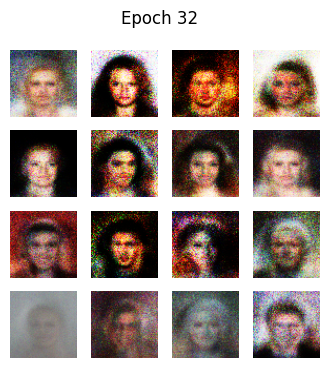

[Epoch 33/100] [Batch 0] [D loss: 0.5092] [G loss: 1.7204]
[Epoch 33/100] [Batch 50] [D loss: 0.4459] [G loss: 1.9427]
[Epoch 33/100] [Batch 100] [D loss: 0.4972] [G loss: 1.7925]
[Epoch 33/100] [Batch 150] [D loss: 0.4898] [G loss: 1.8747]


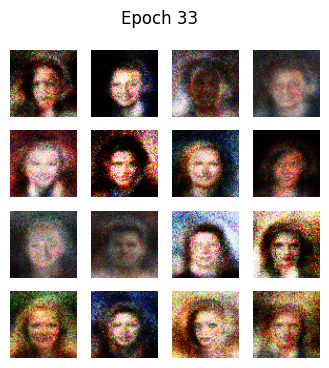

[Epoch 34/100] [Batch 0] [D loss: 0.4559] [G loss: 1.7103]
[Epoch 34/100] [Batch 50] [D loss: 0.4674] [G loss: 1.9216]
[Epoch 34/100] [Batch 100] [D loss: 0.4853] [G loss: 1.8536]
[Epoch 34/100] [Batch 150] [D loss: 0.3614] [G loss: 1.9669]


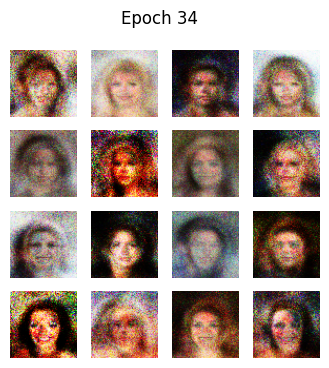

[Epoch 35/100] [Batch 0] [D loss: 0.4266] [G loss: 1.6277]
[Epoch 35/100] [Batch 50] [D loss: 0.4959] [G loss: 2.3868]
[Epoch 35/100] [Batch 100] [D loss: 0.3986] [G loss: 1.9728]
[Epoch 35/100] [Batch 150] [D loss: 0.4701] [G loss: 1.7136]


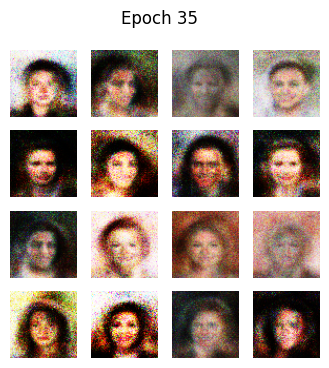

[Epoch 36/100] [Batch 0] [D loss: 0.4542] [G loss: 2.0155]
[Epoch 36/100] [Batch 50] [D loss: 0.5048] [G loss: 1.7205]
[Epoch 36/100] [Batch 100] [D loss: 0.4832] [G loss: 1.7468]
[Epoch 36/100] [Batch 150] [D loss: 0.4628] [G loss: 1.8455]


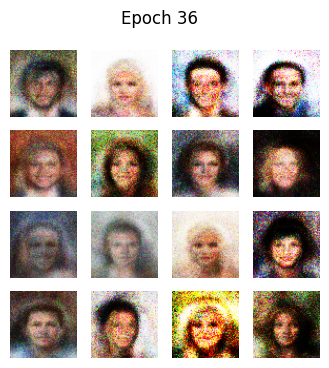

[Epoch 37/100] [Batch 0] [D loss: 0.3809] [G loss: 2.0434]
[Epoch 37/100] [Batch 50] [D loss: 0.4818] [G loss: 2.0771]
[Epoch 37/100] [Batch 100] [D loss: 0.5181] [G loss: 1.5871]
[Epoch 37/100] [Batch 150] [D loss: 0.4316] [G loss: 1.9901]


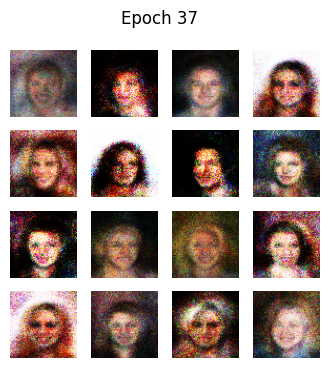

[Epoch 38/100] [Batch 0] [D loss: 0.4813] [G loss: 1.6944]
[Epoch 38/100] [Batch 50] [D loss: 0.4916] [G loss: 1.8919]
[Epoch 38/100] [Batch 100] [D loss: 0.4587] [G loss: 1.8275]
[Epoch 38/100] [Batch 150] [D loss: 0.5415] [G loss: 2.0315]


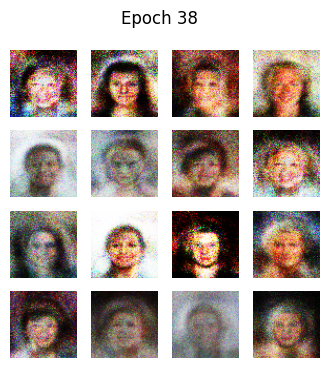

[Epoch 39/100] [Batch 0] [D loss: 0.5038] [G loss: 2.3365]
[Epoch 39/100] [Batch 50] [D loss: 0.4639] [G loss: 1.7406]
[Epoch 39/100] [Batch 100] [D loss: 0.4651] [G loss: 1.7574]
[Epoch 39/100] [Batch 150] [D loss: 0.4647] [G loss: 1.7189]


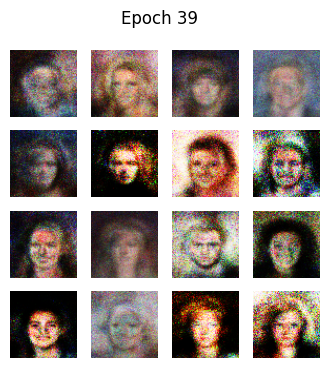

[Epoch 40/100] [Batch 0] [D loss: 0.4788] [G loss: 1.6949]
[Epoch 40/100] [Batch 50] [D loss: 0.4436] [G loss: 1.9956]
[Epoch 40/100] [Batch 100] [D loss: 0.5018] [G loss: 1.8433]
[Epoch 40/100] [Batch 150] [D loss: 0.4910] [G loss: 1.8409]


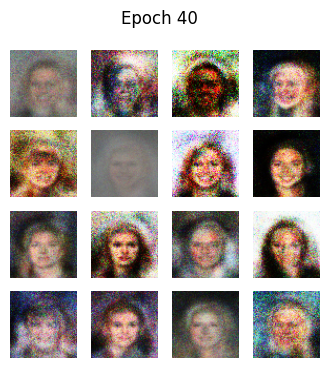

[Epoch 41/100] [Batch 0] [D loss: 0.5074] [G loss: 1.9347]
[Epoch 41/100] [Batch 50] [D loss: 0.5475] [G loss: 1.6728]
[Epoch 41/100] [Batch 100] [D loss: 0.5724] [G loss: 2.1809]
[Epoch 41/100] [Batch 150] [D loss: 0.4690] [G loss: 1.9985]


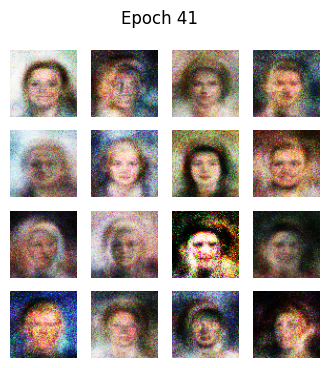

[Epoch 42/100] [Batch 0] [D loss: 0.4377] [G loss: 1.7395]
[Epoch 42/100] [Batch 50] [D loss: 0.4714] [G loss: 1.8577]
[Epoch 42/100] [Batch 100] [D loss: 0.4810] [G loss: 2.1926]
[Epoch 42/100] [Batch 150] [D loss: 0.4330] [G loss: 1.9814]


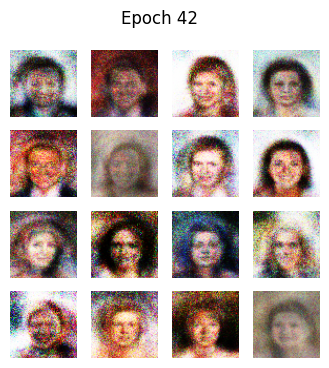

[Epoch 43/100] [Batch 0] [D loss: 0.5539] [G loss: 1.8114]
[Epoch 43/100] [Batch 50] [D loss: 0.4660] [G loss: 1.8155]
[Epoch 43/100] [Batch 100] [D loss: 0.4707] [G loss: 2.0089]
[Epoch 43/100] [Batch 150] [D loss: 0.5056] [G loss: 1.6741]


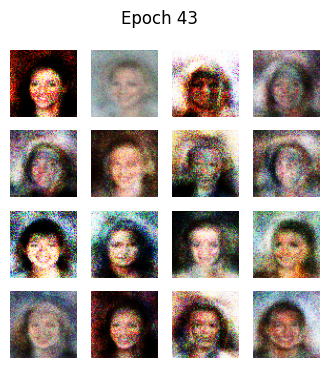

[Epoch 44/100] [Batch 0] [D loss: 0.5264] [G loss: 1.8554]
[Epoch 44/100] [Batch 50] [D loss: 0.4746] [G loss: 1.6053]
[Epoch 44/100] [Batch 100] [D loss: 0.5329] [G loss: 1.8706]
[Epoch 44/100] [Batch 150] [D loss: 0.5576] [G loss: 1.5986]


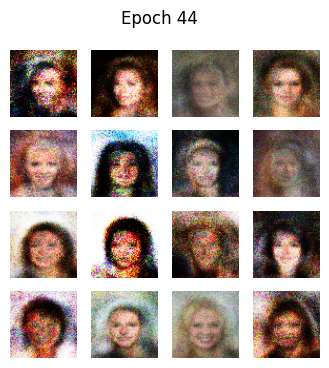

[Epoch 45/100] [Batch 0] [D loss: 0.4395] [G loss: 1.8816]
[Epoch 45/100] [Batch 50] [D loss: 0.5209] [G loss: 1.7430]
[Epoch 45/100] [Batch 100] [D loss: 0.4621] [G loss: 2.2592]
[Epoch 45/100] [Batch 150] [D loss: 0.5454] [G loss: 2.0549]


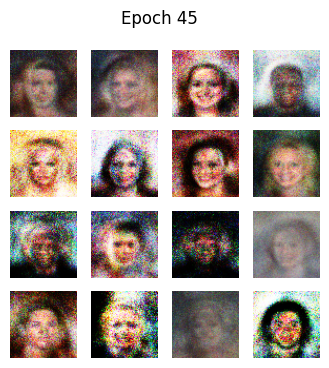

[Epoch 46/100] [Batch 0] [D loss: 0.5724] [G loss: 1.8815]
[Epoch 46/100] [Batch 50] [D loss: 0.5067] [G loss: 1.8537]
[Epoch 46/100] [Batch 100] [D loss: 0.4093] [G loss: 1.9788]
[Epoch 46/100] [Batch 150] [D loss: 0.4292] [G loss: 2.1931]


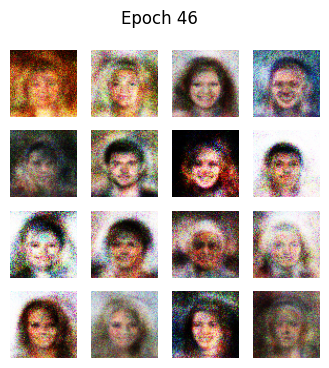

[Epoch 47/100] [Batch 0] [D loss: 0.4686] [G loss: 2.1381]
[Epoch 47/100] [Batch 50] [D loss: 0.4679] [G loss: 1.9451]
[Epoch 47/100] [Batch 100] [D loss: 0.4735] [G loss: 1.9097]
[Epoch 47/100] [Batch 150] [D loss: 0.4524] [G loss: 1.8191]


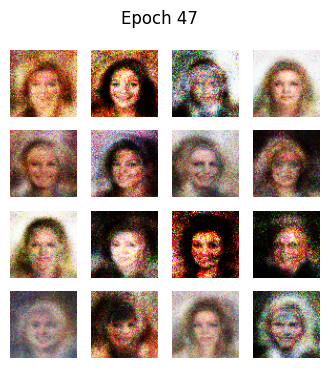

[Epoch 48/100] [Batch 0] [D loss: 0.4659] [G loss: 2.0943]
[Epoch 48/100] [Batch 50] [D loss: 0.4656] [G loss: 1.9383]
[Epoch 48/100] [Batch 100] [D loss: 0.5452] [G loss: 1.7347]
[Epoch 48/100] [Batch 150] [D loss: 0.5063] [G loss: 1.8185]


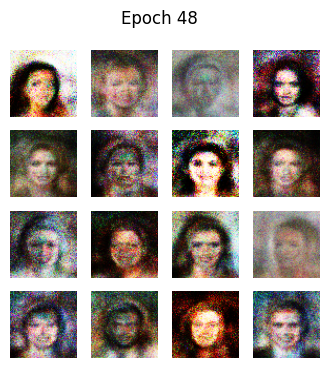

[Epoch 49/100] [Batch 0] [D loss: 0.4601] [G loss: 1.9948]
[Epoch 49/100] [Batch 50] [D loss: 0.5179] [G loss: 1.7045]
[Epoch 49/100] [Batch 100] [D loss: 0.4639] [G loss: 1.5745]
[Epoch 49/100] [Batch 150] [D loss: 0.5047] [G loss: 1.7649]


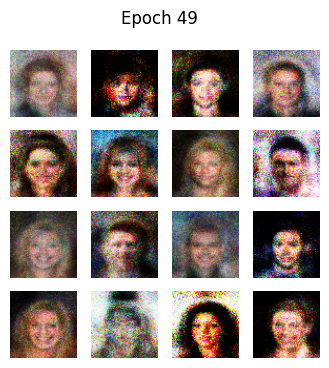

[Epoch 50/100] [Batch 0] [D loss: 0.4707] [G loss: 1.7026]
[Epoch 50/100] [Batch 50] [D loss: 0.4578] [G loss: 2.1775]
[Epoch 50/100] [Batch 100] [D loss: 0.4850] [G loss: 1.7964]
[Epoch 50/100] [Batch 150] [D loss: 0.5273] [G loss: 1.8046]


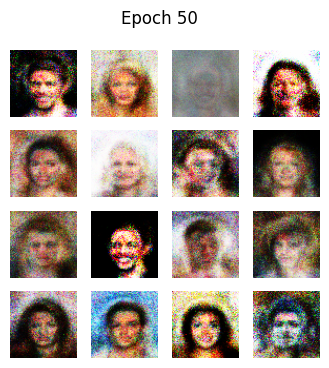

[Epoch 51/100] [Batch 0] [D loss: 0.4893] [G loss: 2.0280]
[Epoch 51/100] [Batch 50] [D loss: 0.4420] [G loss: 1.8587]
[Epoch 51/100] [Batch 100] [D loss: 0.4837] [G loss: 1.7177]
[Epoch 51/100] [Batch 150] [D loss: 0.4826] [G loss: 1.8599]


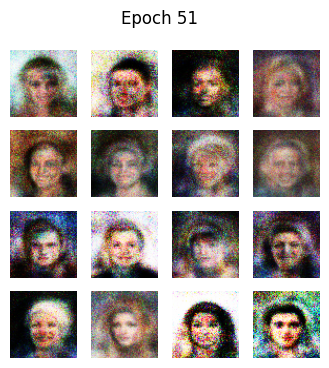

[Epoch 52/100] [Batch 0] [D loss: 0.5789] [G loss: 1.8180]
[Epoch 52/100] [Batch 50] [D loss: 0.4789] [G loss: 1.8165]
[Epoch 52/100] [Batch 100] [D loss: 0.4882] [G loss: 1.8309]
[Epoch 52/100] [Batch 150] [D loss: 0.5127] [G loss: 1.8346]


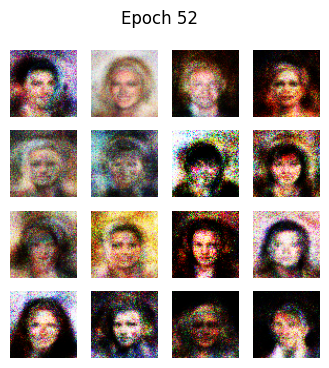

[Epoch 53/100] [Batch 0] [D loss: 0.4705] [G loss: 1.7869]
[Epoch 53/100] [Batch 50] [D loss: 0.5106] [G loss: 1.4269]
[Epoch 53/100] [Batch 100] [D loss: 0.4322] [G loss: 1.9822]
[Epoch 53/100] [Batch 150] [D loss: 0.4940] [G loss: 1.6703]


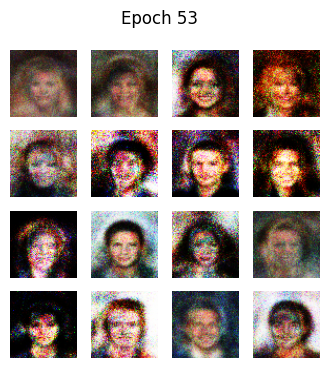

[Epoch 54/100] [Batch 0] [D loss: 0.4799] [G loss: 1.5769]
[Epoch 54/100] [Batch 50] [D loss: 0.4934] [G loss: 1.7695]
[Epoch 54/100] [Batch 100] [D loss: 0.4577] [G loss: 1.9157]
[Epoch 54/100] [Batch 150] [D loss: 0.4970] [G loss: 1.9467]


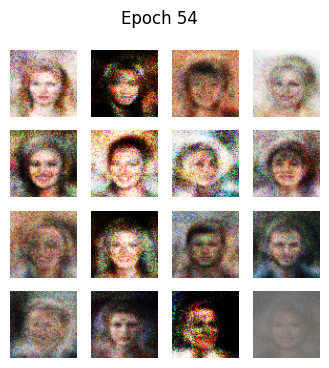

[Epoch 55/100] [Batch 0] [D loss: 0.4545] [G loss: 1.8576]
[Epoch 55/100] [Batch 50] [D loss: 0.4916] [G loss: 1.7550]
[Epoch 55/100] [Batch 100] [D loss: 0.4868] [G loss: 1.7550]
[Epoch 55/100] [Batch 150] [D loss: 0.5552] [G loss: 1.5267]


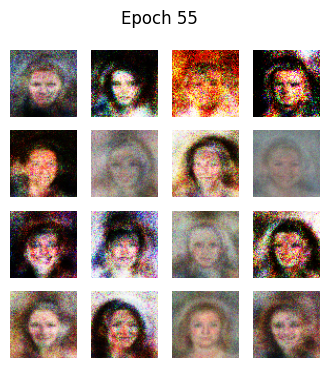

[Epoch 56/100] [Batch 0] [D loss: 0.5132] [G loss: 1.8817]
[Epoch 56/100] [Batch 50] [D loss: 0.4742] [G loss: 2.0566]
[Epoch 56/100] [Batch 100] [D loss: 0.5115] [G loss: 1.8783]
[Epoch 56/100] [Batch 150] [D loss: 0.4776] [G loss: 1.9455]


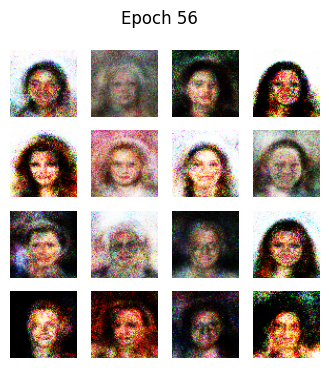

[Epoch 57/100] [Batch 0] [D loss: 0.5215] [G loss: 1.8463]
[Epoch 57/100] [Batch 50] [D loss: 0.4868] [G loss: 1.9194]
[Epoch 57/100] [Batch 100] [D loss: 0.4935] [G loss: 1.7741]
[Epoch 57/100] [Batch 150] [D loss: 0.5156] [G loss: 2.0382]


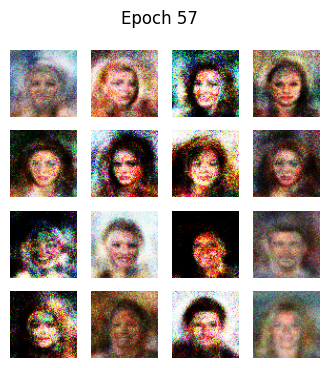

[Epoch 58/100] [Batch 0] [D loss: 0.4641] [G loss: 1.6554]
[Epoch 58/100] [Batch 50] [D loss: 0.4709] [G loss: 1.7738]
[Epoch 58/100] [Batch 100] [D loss: 0.4876] [G loss: 1.7189]
[Epoch 58/100] [Batch 150] [D loss: 0.4202] [G loss: 1.6939]


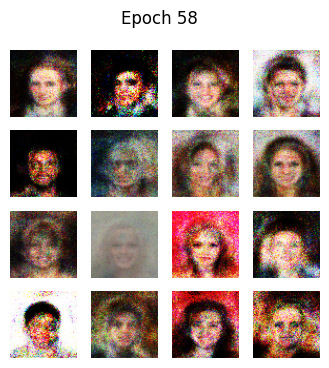

[Epoch 59/100] [Batch 0] [D loss: 0.4548] [G loss: 2.0276]
[Epoch 59/100] [Batch 50] [D loss: 0.5427] [G loss: 1.7076]
[Epoch 59/100] [Batch 100] [D loss: 0.4395] [G loss: 2.1555]
[Epoch 59/100] [Batch 150] [D loss: 0.4854] [G loss: 1.9604]


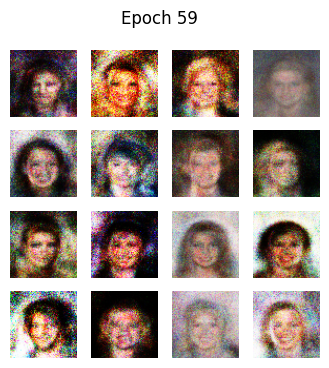

[Epoch 60/100] [Batch 0] [D loss: 0.4577] [G loss: 1.7069]
[Epoch 60/100] [Batch 50] [D loss: 0.4081] [G loss: 1.8437]
[Epoch 60/100] [Batch 100] [D loss: 0.4786] [G loss: 1.5879]
[Epoch 60/100] [Batch 150] [D loss: 0.4872] [G loss: 2.1001]


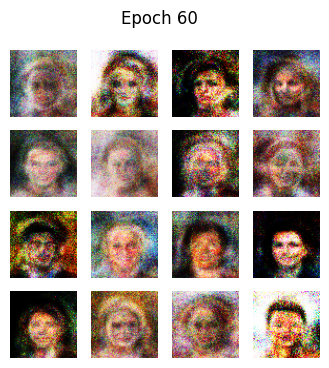

[Epoch 61/100] [Batch 0] [D loss: 0.4895] [G loss: 1.9841]
[Epoch 61/100] [Batch 50] [D loss: 0.5401] [G loss: 1.8104]
[Epoch 61/100] [Batch 100] [D loss: 0.4882] [G loss: 1.9932]
[Epoch 61/100] [Batch 150] [D loss: 0.4904] [G loss: 1.9297]


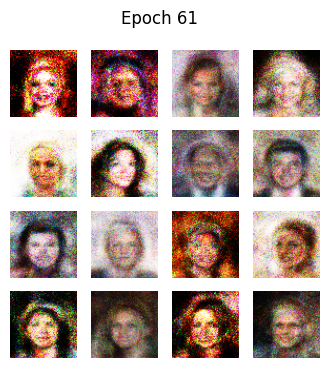

[Epoch 62/100] [Batch 0] [D loss: 0.4838] [G loss: 1.8120]
[Epoch 62/100] [Batch 50] [D loss: 0.4804] [G loss: 1.8896]
[Epoch 62/100] [Batch 100] [D loss: 0.5194] [G loss: 1.8501]
[Epoch 62/100] [Batch 150] [D loss: 0.4758] [G loss: 1.9769]


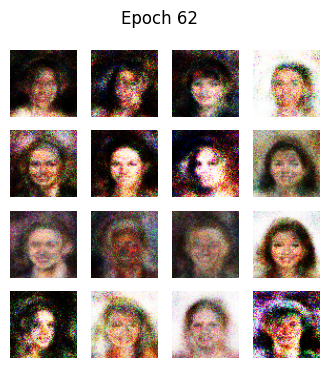

[Epoch 63/100] [Batch 0] [D loss: 0.4748] [G loss: 1.8719]
[Epoch 63/100] [Batch 50] [D loss: 0.4501] [G loss: 2.1501]
[Epoch 63/100] [Batch 100] [D loss: 0.4532] [G loss: 2.0818]
[Epoch 63/100] [Batch 150] [D loss: 0.4914] [G loss: 1.9112]


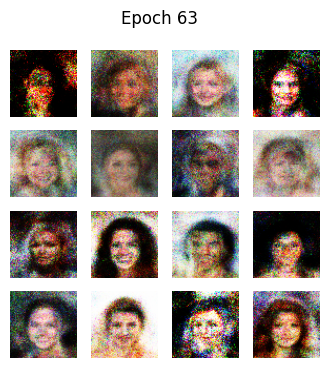

[Epoch 64/100] [Batch 0] [D loss: 0.4698] [G loss: 1.9472]
[Epoch 64/100] [Batch 50] [D loss: 0.4425] [G loss: 1.8870]
[Epoch 64/100] [Batch 100] [D loss: 0.5408] [G loss: 2.0004]
[Epoch 64/100] [Batch 150] [D loss: 0.4129] [G loss: 1.9262]


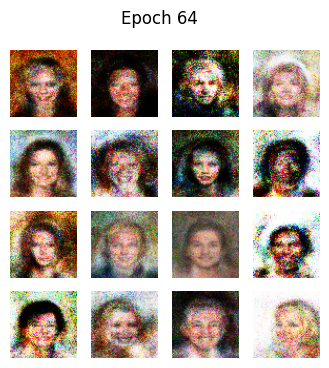

[Epoch 65/100] [Batch 0] [D loss: 0.4758] [G loss: 1.8090]
[Epoch 65/100] [Batch 50] [D loss: 0.4548] [G loss: 2.0985]
[Epoch 65/100] [Batch 100] [D loss: 0.4447] [G loss: 1.8234]
[Epoch 65/100] [Batch 150] [D loss: 0.4988] [G loss: 1.5948]


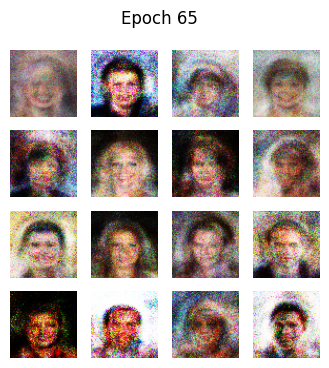

[Epoch 66/100] [Batch 0] [D loss: 0.4336] [G loss: 1.8135]
[Epoch 66/100] [Batch 50] [D loss: 0.4077] [G loss: 1.9639]
[Epoch 66/100] [Batch 100] [D loss: 0.4270] [G loss: 1.9615]
[Epoch 66/100] [Batch 150] [D loss: 0.4693] [G loss: 1.8542]


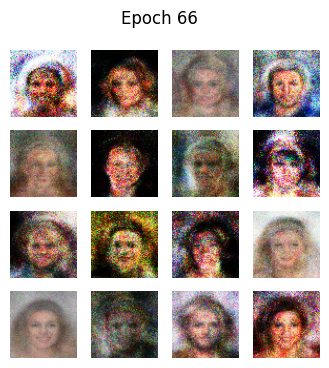

[Epoch 67/100] [Batch 0] [D loss: 0.4894] [G loss: 1.7953]
[Epoch 67/100] [Batch 50] [D loss: 0.4322] [G loss: 1.8247]
[Epoch 67/100] [Batch 100] [D loss: 0.4534] [G loss: 1.8631]
[Epoch 67/100] [Batch 150] [D loss: 0.4532] [G loss: 2.0325]


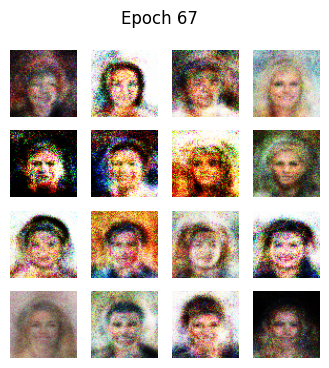

[Epoch 68/100] [Batch 0] [D loss: 0.4849] [G loss: 1.8142]
[Epoch 68/100] [Batch 50] [D loss: 0.4366] [G loss: 1.9033]
[Epoch 68/100] [Batch 100] [D loss: 0.5263] [G loss: 2.3366]
[Epoch 68/100] [Batch 150] [D loss: 0.5624] [G loss: 1.6951]


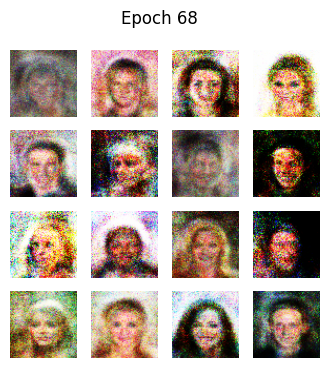

[Epoch 69/100] [Batch 0] [D loss: 0.4808] [G loss: 1.9228]
[Epoch 69/100] [Batch 50] [D loss: 0.5097] [G loss: 1.8637]
[Epoch 69/100] [Batch 100] [D loss: 0.4810] [G loss: 1.7928]
[Epoch 69/100] [Batch 150] [D loss: 0.4556] [G loss: 1.9041]


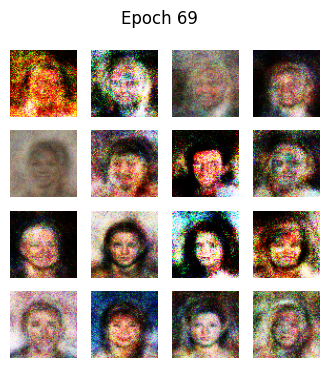

[Epoch 70/100] [Batch 0] [D loss: 0.4619] [G loss: 1.6404]
[Epoch 70/100] [Batch 50] [D loss: 0.4488] [G loss: 1.9245]
[Epoch 70/100] [Batch 100] [D loss: 0.4456] [G loss: 1.9772]
[Epoch 70/100] [Batch 150] [D loss: 0.4984] [G loss: 1.9514]


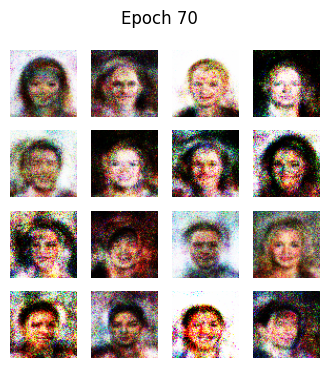

[Epoch 71/100] [Batch 0] [D loss: 0.4341] [G loss: 1.7080]
[Epoch 71/100] [Batch 50] [D loss: 0.4420] [G loss: 2.3317]
[Epoch 71/100] [Batch 100] [D loss: 0.4088] [G loss: 2.0203]
[Epoch 71/100] [Batch 150] [D loss: 0.4039] [G loss: 1.8215]


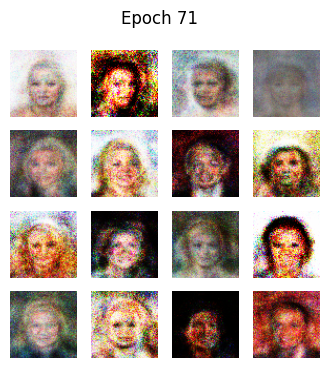

[Epoch 72/100] [Batch 0] [D loss: 0.4714] [G loss: 1.8090]
[Epoch 72/100] [Batch 50] [D loss: 0.4243] [G loss: 1.8230]
[Epoch 72/100] [Batch 100] [D loss: 0.4187] [G loss: 2.0834]
[Epoch 72/100] [Batch 150] [D loss: 0.5459] [G loss: 1.9659]


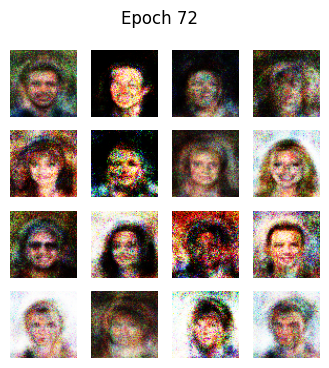

[Epoch 73/100] [Batch 0] [D loss: 0.4274] [G loss: 1.9250]
[Epoch 73/100] [Batch 50] [D loss: 0.5557] [G loss: 2.0400]
[Epoch 73/100] [Batch 100] [D loss: 0.4291] [G loss: 2.0196]
[Epoch 73/100] [Batch 150] [D loss: 0.4259] [G loss: 1.8139]


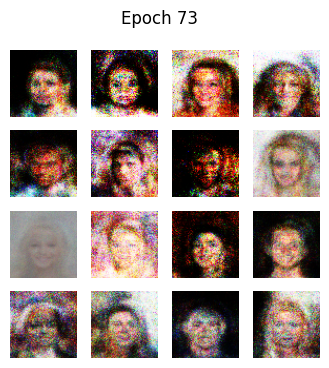

[Epoch 74/100] [Batch 0] [D loss: 0.5244] [G loss: 2.0009]
[Epoch 74/100] [Batch 50] [D loss: 0.5399] [G loss: 1.5147]
[Epoch 74/100] [Batch 100] [D loss: 0.4473] [G loss: 1.7417]
[Epoch 74/100] [Batch 150] [D loss: 0.4427] [G loss: 1.9001]


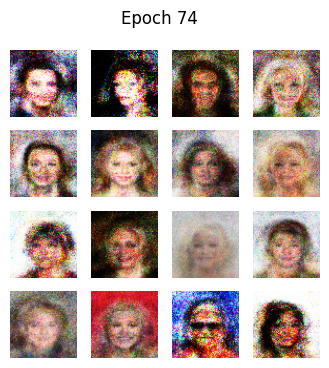

[Epoch 75/100] [Batch 0] [D loss: 0.4236] [G loss: 1.9337]
[Epoch 75/100] [Batch 50] [D loss: 0.4214] [G loss: 1.7845]
[Epoch 75/100] [Batch 100] [D loss: 0.4434] [G loss: 1.8172]
[Epoch 75/100] [Batch 150] [D loss: 0.4665] [G loss: 1.9944]


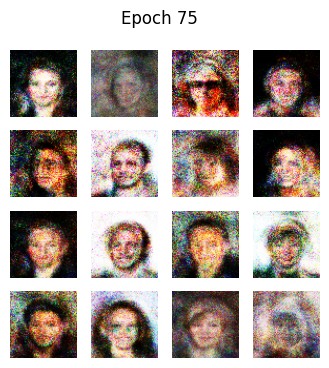

[Epoch 76/100] [Batch 0] [D loss: 0.4840] [G loss: 1.8883]
[Epoch 76/100] [Batch 50] [D loss: 0.4197] [G loss: 1.8732]
[Epoch 76/100] [Batch 100] [D loss: 0.4396] [G loss: 1.8608]
[Epoch 76/100] [Batch 150] [D loss: 0.4717] [G loss: 1.8197]


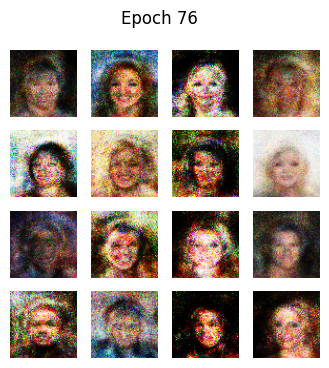

[Epoch 77/100] [Batch 0] [D loss: 0.4577] [G loss: 2.0674]
[Epoch 77/100] [Batch 50] [D loss: 0.4521] [G loss: 2.0562]
[Epoch 77/100] [Batch 100] [D loss: 0.4546] [G loss: 1.8583]
[Epoch 77/100] [Batch 150] [D loss: 0.4462] [G loss: 2.0343]


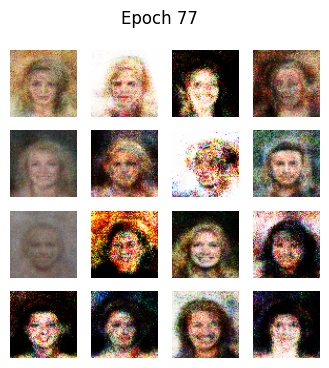

[Epoch 78/100] [Batch 0] [D loss: 0.4348] [G loss: 2.0809]
[Epoch 78/100] [Batch 50] [D loss: 0.4716] [G loss: 2.0879]
[Epoch 78/100] [Batch 100] [D loss: 0.4117] [G loss: 1.8720]
[Epoch 78/100] [Batch 150] [D loss: 0.4214] [G loss: 1.9056]


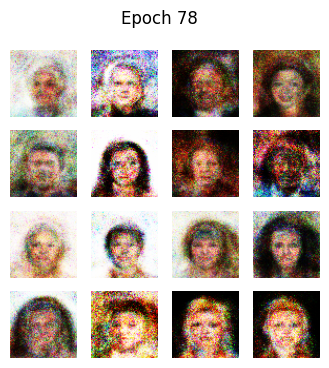

[Epoch 79/100] [Batch 0] [D loss: 0.4759] [G loss: 1.9890]
[Epoch 79/100] [Batch 50] [D loss: 0.4181] [G loss: 2.0053]
[Epoch 79/100] [Batch 100] [D loss: 0.3749] [G loss: 1.8100]
[Epoch 79/100] [Batch 150] [D loss: 0.5145] [G loss: 2.0086]


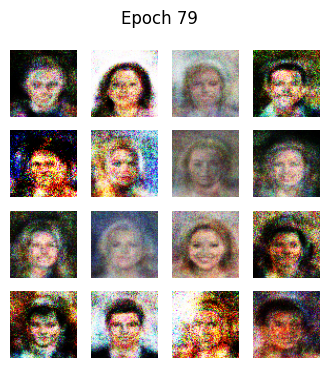

[Epoch 80/100] [Batch 0] [D loss: 0.4748] [G loss: 1.9680]
[Epoch 80/100] [Batch 50] [D loss: 0.4353] [G loss: 1.9187]
[Epoch 80/100] [Batch 100] [D loss: 0.4700] [G loss: 2.0034]
[Epoch 80/100] [Batch 150] [D loss: 0.4671] [G loss: 1.9532]


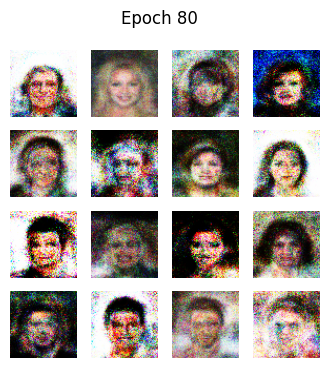

[Epoch 81/100] [Batch 0] [D loss: 0.6082] [G loss: 2.1203]
[Epoch 81/100] [Batch 50] [D loss: 0.4529] [G loss: 1.6848]
[Epoch 81/100] [Batch 100] [D loss: 0.4263] [G loss: 1.9369]
[Epoch 81/100] [Batch 150] [D loss: 0.4008] [G loss: 1.8641]


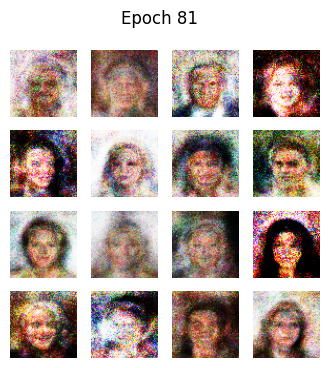

[Epoch 82/100] [Batch 0] [D loss: 0.4906] [G loss: 2.1376]
[Epoch 82/100] [Batch 50] [D loss: 0.4806] [G loss: 2.0001]
[Epoch 82/100] [Batch 100] [D loss: 0.4070] [G loss: 1.8760]
[Epoch 82/100] [Batch 150] [D loss: 0.4309] [G loss: 2.0903]


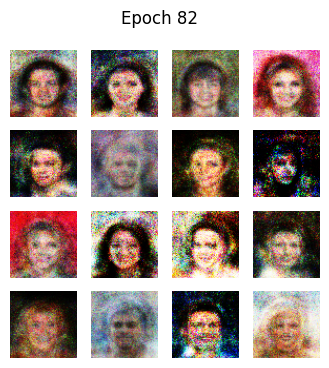

[Epoch 83/100] [Batch 0] [D loss: 0.4387] [G loss: 1.9457]
[Epoch 83/100] [Batch 50] [D loss: 0.4950] [G loss: 2.0169]
[Epoch 83/100] [Batch 100] [D loss: 0.4353] [G loss: 1.9776]
[Epoch 83/100] [Batch 150] [D loss: 0.4054] [G loss: 2.0344]


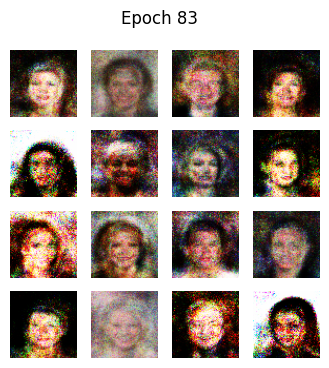

[Epoch 84/100] [Batch 0] [D loss: 0.5250] [G loss: 2.3643]
[Epoch 84/100] [Batch 50] [D loss: 0.3872] [G loss: 2.0483]
[Epoch 84/100] [Batch 100] [D loss: 0.4939] [G loss: 1.8674]
[Epoch 84/100] [Batch 150] [D loss: 0.3954] [G loss: 2.1014]


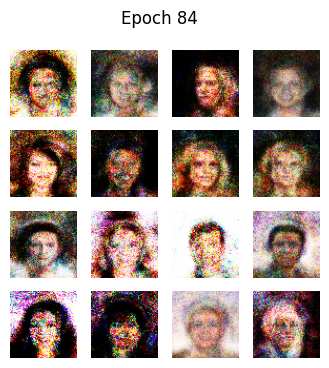

[Epoch 85/100] [Batch 0] [D loss: 0.4588] [G loss: 2.0661]
[Epoch 85/100] [Batch 50] [D loss: 0.4819] [G loss: 1.9632]
[Epoch 85/100] [Batch 100] [D loss: 0.4556] [G loss: 2.3129]
[Epoch 85/100] [Batch 150] [D loss: 0.4331] [G loss: 1.9246]


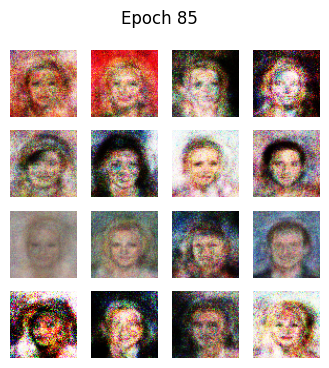

[Epoch 86/100] [Batch 0] [D loss: 0.4383] [G loss: 1.9621]
[Epoch 86/100] [Batch 50] [D loss: 0.3981] [G loss: 2.2266]
[Epoch 86/100] [Batch 100] [D loss: 0.4414] [G loss: 1.8794]
[Epoch 86/100] [Batch 150] [D loss: 0.4236] [G loss: 1.9232]


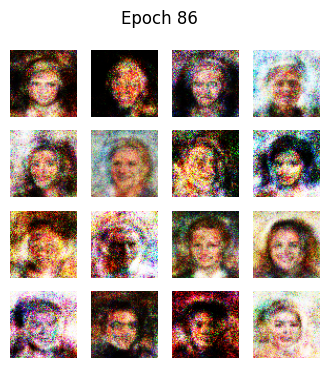

[Epoch 87/100] [Batch 0] [D loss: 0.5114] [G loss: 1.8114]
[Epoch 87/100] [Batch 50] [D loss: 0.4580] [G loss: 1.9778]
[Epoch 87/100] [Batch 100] [D loss: 0.4334] [G loss: 2.0003]
[Epoch 87/100] [Batch 150] [D loss: 0.4588] [G loss: 2.1282]


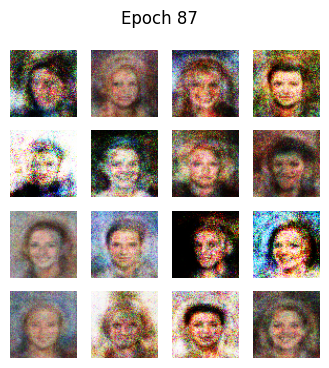

[Epoch 88/100] [Batch 0] [D loss: 0.3882] [G loss: 2.2997]
[Epoch 88/100] [Batch 50] [D loss: 0.3872] [G loss: 2.0251]
[Epoch 88/100] [Batch 100] [D loss: 0.3737] [G loss: 1.9680]
[Epoch 88/100] [Batch 150] [D loss: 0.4261] [G loss: 2.2206]


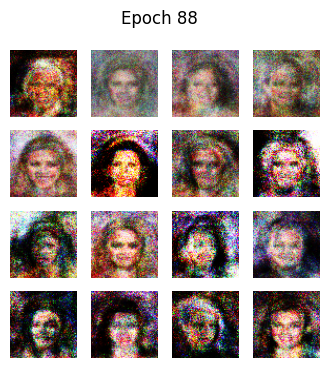

[Epoch 89/100] [Batch 0] [D loss: 0.4841] [G loss: 2.2721]
[Epoch 89/100] [Batch 50] [D loss: 0.3967] [G loss: 1.9934]
[Epoch 89/100] [Batch 100] [D loss: 0.3636] [G loss: 2.1266]
[Epoch 89/100] [Batch 150] [D loss: 0.4201] [G loss: 2.0736]


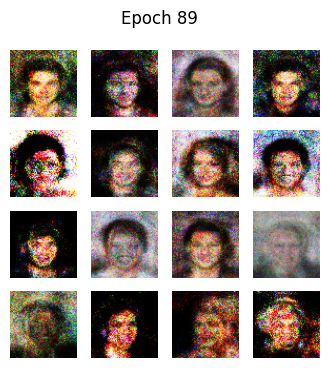

[Epoch 90/100] [Batch 0] [D loss: 0.4878] [G loss: 1.9379]
[Epoch 90/100] [Batch 50] [D loss: 0.4456] [G loss: 1.9098]
[Epoch 90/100] [Batch 100] [D loss: 0.4438] [G loss: 2.1271]
[Epoch 90/100] [Batch 150] [D loss: 0.3567] [G loss: 2.1089]


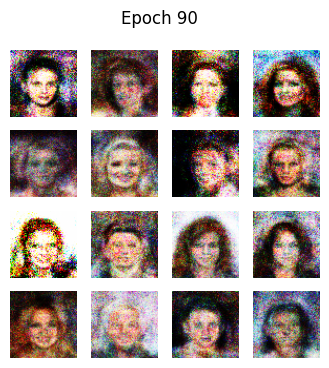

[Epoch 91/100] [Batch 0] [D loss: 0.3662] [G loss: 2.2089]
[Epoch 91/100] [Batch 50] [D loss: 0.4600] [G loss: 1.9783]
[Epoch 91/100] [Batch 100] [D loss: 0.4534] [G loss: 2.1952]
[Epoch 91/100] [Batch 150] [D loss: 0.5689] [G loss: 2.0207]


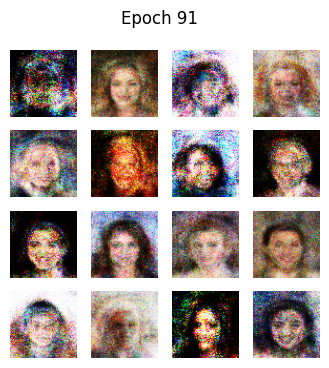

[Epoch 92/100] [Batch 0] [D loss: 0.4275] [G loss: 2.1239]
[Epoch 92/100] [Batch 50] [D loss: 0.4345] [G loss: 2.2235]
[Epoch 92/100] [Batch 100] [D loss: 0.4319] [G loss: 1.9433]
[Epoch 92/100] [Batch 150] [D loss: 0.4125] [G loss: 2.2424]


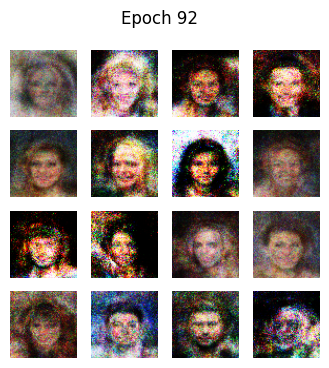

[Epoch 93/100] [Batch 0] [D loss: 0.4639] [G loss: 2.1445]
[Epoch 93/100] [Batch 50] [D loss: 0.4653] [G loss: 2.1682]
[Epoch 93/100] [Batch 100] [D loss: 0.4583] [G loss: 2.1260]
[Epoch 93/100] [Batch 150] [D loss: 0.4053] [G loss: 2.2527]


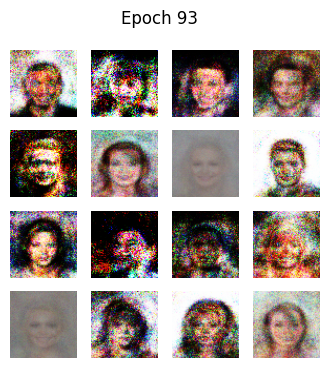

[Epoch 94/100] [Batch 0] [D loss: 0.5141] [G loss: 1.9070]
[Epoch 94/100] [Batch 50] [D loss: 0.3811] [G loss: 2.3031]
[Epoch 94/100] [Batch 100] [D loss: 0.3531] [G loss: 2.1560]
[Epoch 94/100] [Batch 150] [D loss: 0.4604] [G loss: 2.1161]


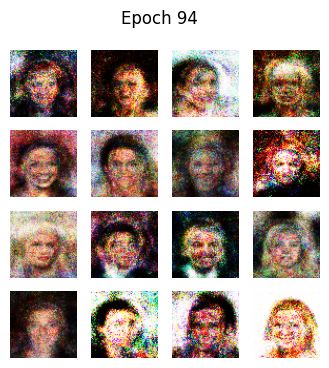

[Epoch 95/100] [Batch 0] [D loss: 0.4383] [G loss: 2.1328]
[Epoch 95/100] [Batch 50] [D loss: 0.4564] [G loss: 1.9646]
[Epoch 95/100] [Batch 100] [D loss: 0.4360] [G loss: 1.9379]
[Epoch 95/100] [Batch 150] [D loss: 0.4050] [G loss: 2.1964]


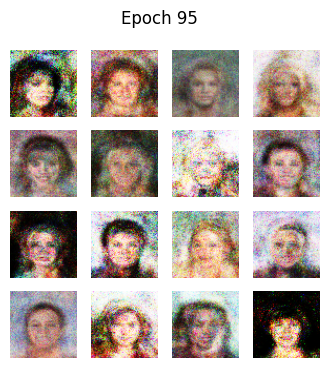

[Epoch 96/100] [Batch 0] [D loss: 0.4519] [G loss: 2.0385]
[Epoch 96/100] [Batch 50] [D loss: 0.4007] [G loss: 2.1306]
[Epoch 96/100] [Batch 100] [D loss: 0.4279] [G loss: 2.3768]
[Epoch 96/100] [Batch 150] [D loss: 0.4176] [G loss: 2.5308]


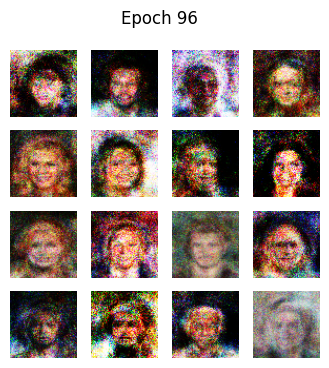

[Epoch 97/100] [Batch 0] [D loss: 0.3722] [G loss: 1.8885]
[Epoch 97/100] [Batch 50] [D loss: 0.4098] [G loss: 2.1987]
[Epoch 97/100] [Batch 100] [D loss: 0.4355] [G loss: 2.1813]
[Epoch 97/100] [Batch 150] [D loss: 0.4016] [G loss: 1.9921]


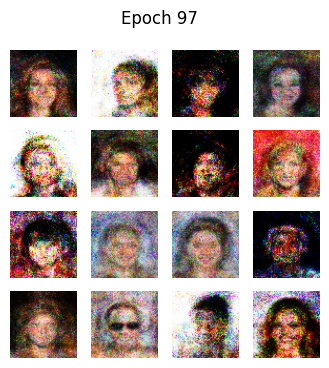

[Epoch 98/100] [Batch 0] [D loss: 0.4088] [G loss: 2.3835]
[Epoch 98/100] [Batch 50] [D loss: 0.3964] [G loss: 2.3267]
[Epoch 98/100] [Batch 100] [D loss: 0.4593] [G loss: 2.2873]
[Epoch 98/100] [Batch 150] [D loss: 0.4463] [G loss: 2.0508]


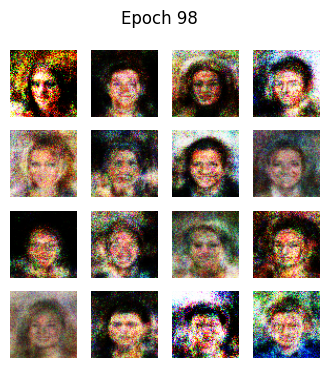

[Epoch 99/100] [Batch 0] [D loss: 0.4484] [G loss: 1.9419]
[Epoch 99/100] [Batch 50] [D loss: 0.3712] [G loss: 2.1192]
[Epoch 99/100] [Batch 100] [D loss: 0.3695] [G loss: 2.1584]
[Epoch 99/100] [Batch 150] [D loss: 0.3954] [G loss: 2.2752]


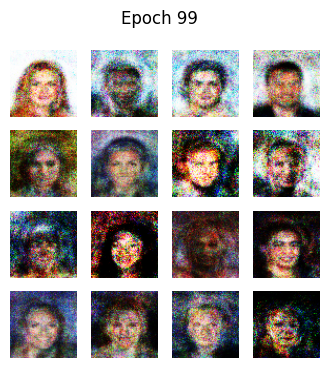

In [16]:
#trraning
train(dataset, epochs=100)